# Вычислительное музыковедение: Модели и методы Music Data Mining

## Лабораторная работа №1. Работа с звуковыми сигналами на Python

### Введение в звуковые сигналы



**Интерактивный сервис**: https://musiclab.chromeexperiments.com/

**Звук** - это аналоговый сигнал. **Сигнал** – зависимость одной величины от другой (функция). Например, зависимость давления воздуха в точке от времени можно рассматривать как звуковой сигнал. Зависимость напряжения в проводнике от времени тоже может представлять звуковой сигнал

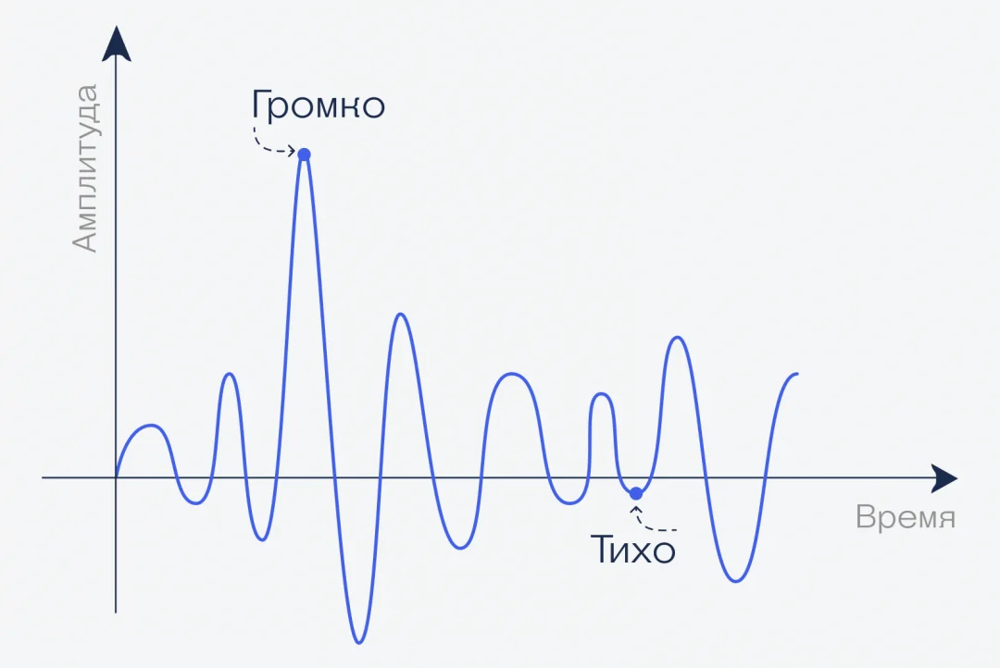

Частота в герцах (Гц) – это число повторяющихся событий периодического процесса
в секунду. Например: Частота вращения f – это число циклов в секунду. Частота
дискретизации сигнала Fs – это число отсчетов в секунду. Помимо герц,
используются и другие единицы измерения частоты.

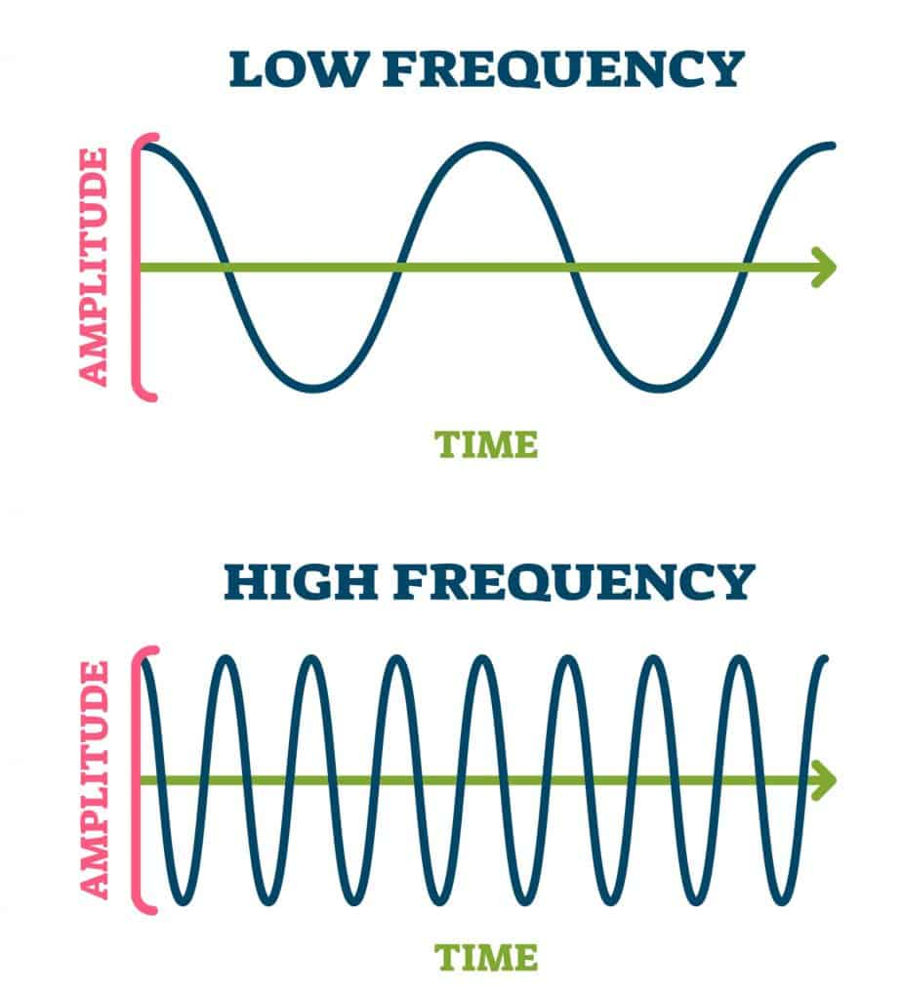

**Цифровой сигнал** - это сигнал дискретный, квантованный и закодированный (прямой, обратный, дополн. коды).

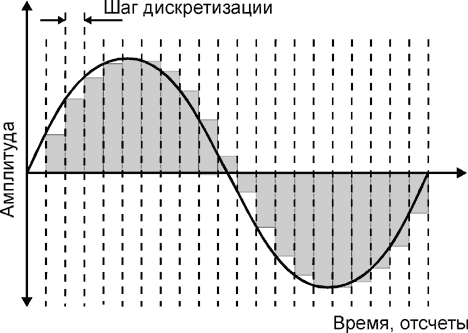

In [1]:
# Рассматриваемый звук лежит тут: https://disk.yandex.ru/d/_CbJnYBDiNcjyQ

# пакет Python для анализа музыки и аудио.
import librosa

name_file = "divnyiy-utrenniy-zvuk-peniya.wav"

"""
метод load считывает звуковой файл формата .wav
s - сигнал
sr - частота дискритизации
https://librosa.org/doc/main/generated/librosa.load.html
"""
s, sr = librosa.load(name_file, sr=None)

In [2]:
print(f" Сигнал = {s}\n Размер = {s.shape}\n Частота дискритизации = {sr}\n Длительность = {s.shape[0] / sr}\n")

 Сигнал = [ 4.5776367e-04  3.3569336e-04 -4.8828125e-04 ...  9.1552734e-05
 -6.1035156e-04 -3.3569336e-04]
 Размер = (160056,)
 Частота дискритизации = 22050
 Длительность = 7.258775510204082



In [3]:
# IPython пакет для воспроизведения аудио в Google Colab
import IPython.display as ipd

ipd.Audio(s,rate=sr)

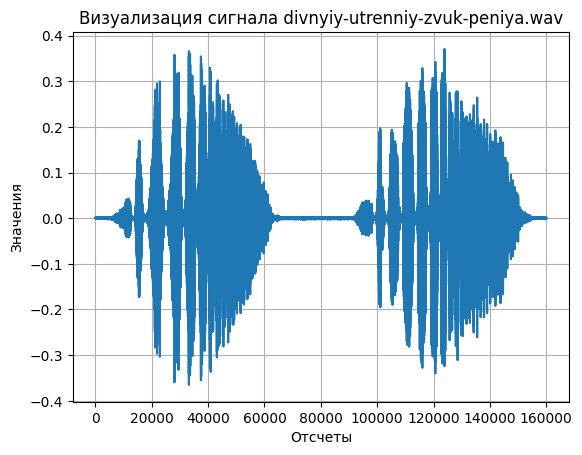

In [4]:
import matplotlib.pyplot as plt

plt.plot(s)
plt.grid()
plt.xlabel("Отсчеты")
plt.ylabel("Значения")
plt.title(f"Визуализация сигнала {name_file}")
plt.show()

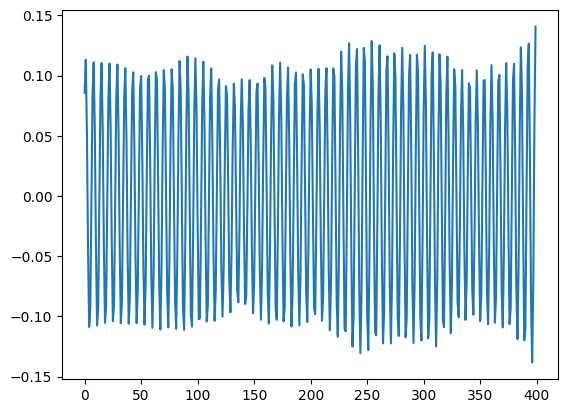

In [5]:
plt.plot(s[20000:20400]); plt.show()

### Задание 1. Частота дискретизации (1 балл).

1. Добавьте любой аудиофрагмент (5-10 секунд) и считайте этот wav файл для работы с сигналом. Визуализируйте с помощью matplotlib.
2. Какая частота дескритизации?
3. Проиграйте этот аудиофрагмент с помощью **ipd.Audio**
4. Проиграйте этот же аудиофрагмент, но указав другие частоты дискритизации (например, в два раза выше и в два раза ниже)
5. Объясните изменение звучания

The song I use here is considered to be lost media. The search for the author of 'Everyone Knows That' is still in progress.

In [63]:
ekt, sr = librosa.load('/content/everyone_knows_that.wav', sr=None)
print(f'Sampling rate: {sr}')

Sampling rate: 44100


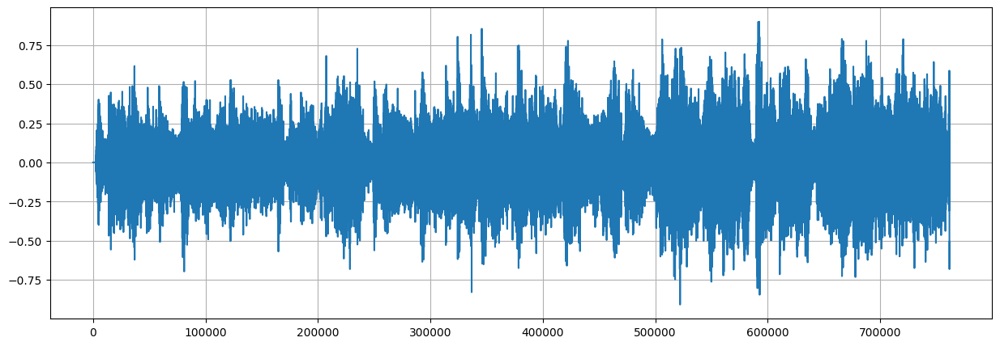

In [64]:
plt.figure(figsize=(15, 5))
plt.grid()
plt.plot(ekt)
plt.show()

In [65]:
# original sampling rate
ipd.Audio(ekt, rate=sr)

In [66]:
# lower sampling rate -- 'slowed + reverb'
ipd.Audio(ekt, rate=sr//1.11)

In [67]:
# higher sampling rate -- speedup
ipd.Audio(ekt, rate=sr//0.9)

**Explanation**: Audio sampling rate is proportional to pitch. The smaller the sampling rate, the lower the audio sounds.

### FFT

In [68]:
def get_spectrum(data, sr=44100):
    fourier_transform = np.fft.fft(data)
    abs_fourier_transform = np.abs(fourier_transform)
    power_spectrum = np.sqrt(abs_fourier_transform)
    frequency = np.linspace(0, sr/2, len(power_spectrum))
    return frequency, power_spectrum

In [70]:
ipd.Audio(ekt, rate=44100)

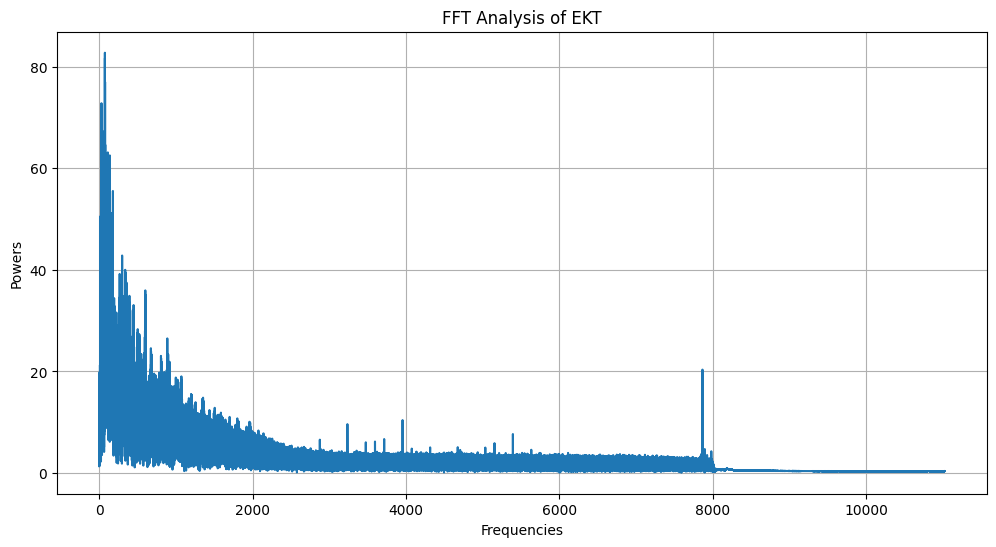

In [83]:
freqs, powers = get_spectrum(ekt)
plt.figure(figsize=(12, 6))
plt.plot(freqs[:len(freqs) // 2], powers[:len(freqs) // 2])
plt.grid()
plt.xlabel("Frequencies")
plt.ylabel("Powers")
plt.title(f"FFT Analysis of EKT")
plt.show()

### Задание 2. Гармонические колебания (2 балла).

**Гармонические колебания** - колебания, при которых физическая величина изменяется с течением времени по гармоническому (синусоидальному/косинусоидальному) закону.

$$y = A*sin(\omega*t + \varphi_0)$$
$ A $ - амплитула  
$ \omega $ - циклическая частота (радиан/с)  
$ \varphi_0 $  - фаза (сдвиг)  
$ t $ - время или отсчеты   
$$ \omega = 2*\pi*f $$  
$f$ - частота в Герцах


Для того, чтобы сгенерировать звуковой сигнал заданной частоты $freq$ длительностью $dur$ (в секундах) с частотой дискретизации $sr$, необходимо:  
1. Создать вектор отсчетов времени $[0, 1, 2, ..., sr*dur]$
2. Реализовать формулу выше ($A$ и $\varphi_0$ должны задаваться)

In [11]:
import numpy as np
import IPython.display as ipd

# Необходимо реализовать функцию create_sin
def create_sin(freq,          # частота звучания
               dur=1.0,       # длительность
               sr=44100.0,    # частота дескритизации
               a=1.0,         # амплитуда
               ph = 0.0):     # фаза (сдвиг)
    time = np.arange(0, sr * dur)
    omega = 2 * 3.14 * freq / sr
    sine = a * np.sin(omega * time + ph)
    return sine

In [12]:
c = 261.626 # Частота ДО в первой октаве
sr = 44100
sin_signal = create_sin(c, 3.0, sr)
# plt.plot(sin_signal)
# plt.show()
ipd.Audio(sin_signal, rate=sr)

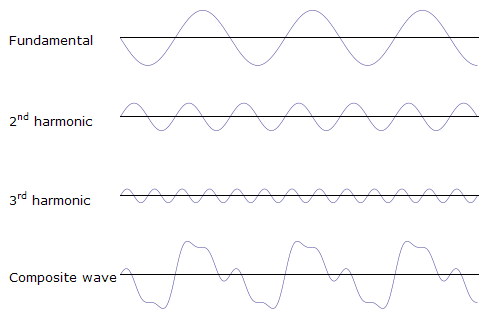

In [13]:
# Реализуйте функцию суммирования сигналов
def sum_signals(
    signals #список сигналов
):
  return np.array(signals).sum(axis=0)

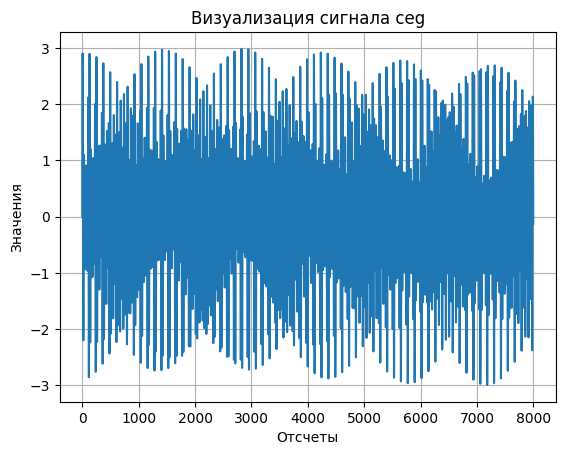

In [14]:
c = 261.626   # Частота ДО в первой октаве
e = 329.6     # Частота МИ в первой октаве
g = 392       # Частота СОЛЬ в первой октаве
sr = 8000
signal = sum_signals([create_sin(c, 1.0, sr),
                     create_sin(e, 1.0, sr),
                     create_sin(g, 1.0, sr),])

plt.plot(signal)
plt.grid()
plt.xlabel("Отсчеты")
plt.ylabel("Значения")
plt.title(f"Визуализация сигнала ceg")
plt.show()

ipd.Audio(signal, rate=sr)

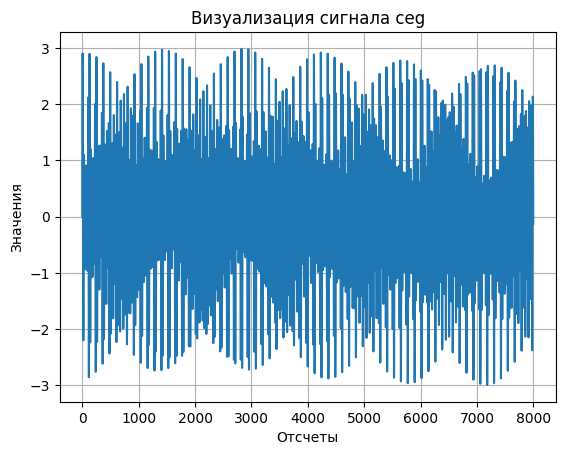

In [15]:
c = 261.626   # Частота ДО в первой октаве
e = 329.6     # Частота МИ в первой октаве
g = 392       # Частота СОЛЬ в первой октаве
sr = 8000
signal = sum_signals([create_sin(c, 1.0, sr),
                     create_sin(e, 1.0, sr),
                     create_sin(g, 1.0, sr),])

plt.plot(signal)
plt.grid()
plt.xlabel("Отсчеты")
plt.ylabel("Значения")
plt.title(f"Визуализация сигнала ceg")
plt.show()

ipd.Audio(signal, rate=sr)

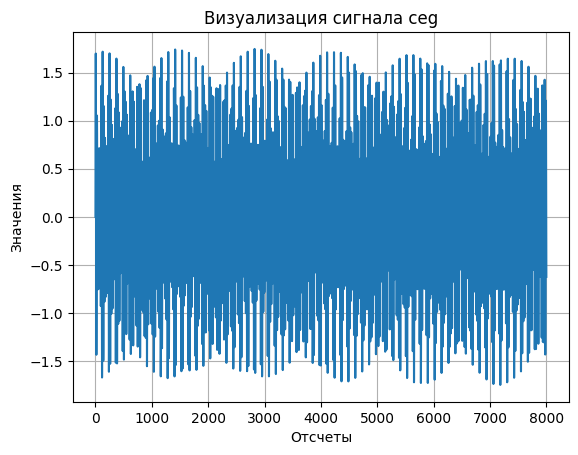

In [16]:
signal = sum_signals([create_sin(c, 1.0, sr, 0.25),
                     create_sin(e, 1.0, sr, 0.5),
                     create_sin(g, 1.0, sr, 1.0),])

plt.plot(signal)
plt.grid()
plt.xlabel("Отсчеты")
plt.ylabel("Значения")
plt.title(f"Визуализация сигнала ceg")
plt.show()

ipd.Audio(signal, rate=sr)

### Задание 3. Гармоники (1 балл).

[Оберто́ны](https://ru.wikipedia.org/wiki/%D0%9E%D0%B1%D0%B5%D1%80%D1%82%D0%BE%D0%BD) (нем. Ober — высокий, Ton — звук) в акустике — призвуки, входящие в спектр музыкального звука; высота обертонов выше основного тона (отсюда название). Наличие обертонов обусловлено сложной картиной колебаний звучащего тела (струны, столба воздуха, мембраны, голосовых связок и т.д.): частоты обертонов соответствуют частотам колебания его частей.

Обертоны бывают гармоническими и негармоническими. Частоты гармонических обертонов больше частоты основного тона в 2, 3, 4, 5 и т.д. раз (кратность равна натуральному числу). Гармонические обертоны вместе с основным тоном называются [гармониками](https://ru.wikipedia.org/wiki/%D0%93%D0%B0%D1%80%D0%BC%D0%BE%D0%BD%D0%B8%D0%BA%D0%B0_(%D0%BC%D1%83%D0%B7%D1%8B%D0%BA%D0%B0) и образуют натуральный звукоряд.



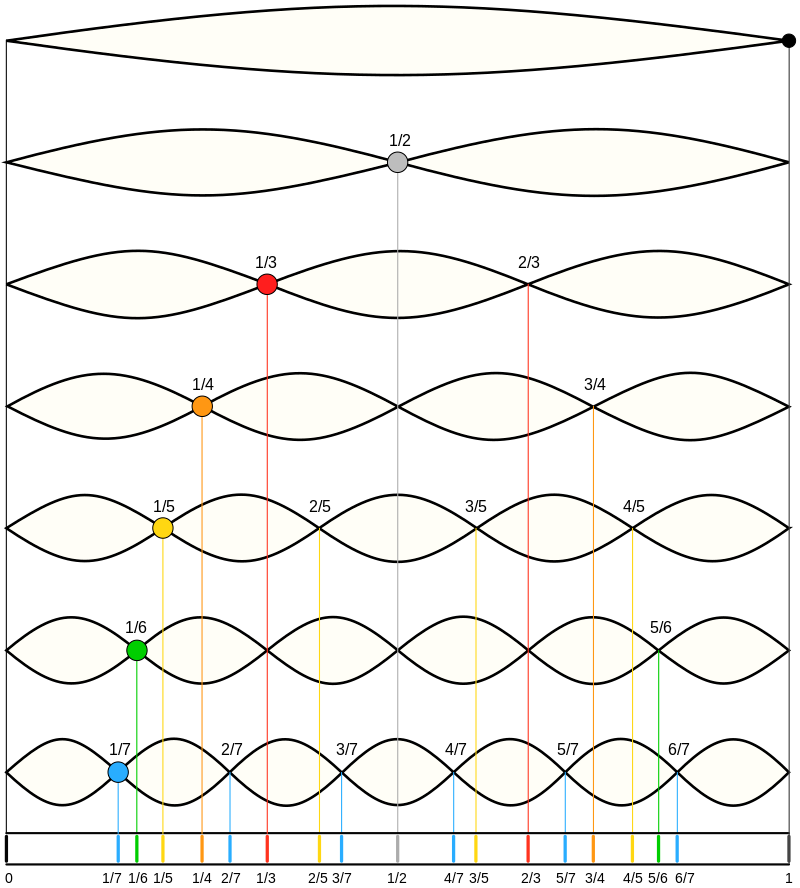

In [17]:
c = 261.626   # Частота ДО в первой октаве
sr = 44100
signal = sum_signals([create_sin(c, 1.0, sr, 1.0),
                     create_sin(2*c, 1.0, sr, 0.3),
                     create_sin(3*c, 1.0, sr, 0.2),
                     create_sin(4*c, 1.0, sr, 0.1),
                     create_sin(5*c, 1.0, sr, 0.05),])

ipd.Audio(signal, rate=sr)

In [45]:
# Реализуйте функцию для генерации сигнала с гармониками
# Можете использовать реализованные функции
def harmonics(freq,             # основная частота
              dur=1.0,          # длительность
              sr=44100.0,       # астота дискретизации
              amps = [1.0]      # список с амплитудами гармоник
              ):
    amps = np.array(amps) / max(amps)
    data = sum_signals([create_sin(freq * (1 + i), dur, sr, amps[i]) for i in range(len(amps))])
    return data

In [46]:
signal_with_harmon = harmonics(c, 1.0, sr, [1.0, 1/5, 1/6, 1/7, 1/8, 1/9])
ipd.Audio(signal_with_harmon, rate=sr)

### Задание 4. MIDI (2 балла).

Онлайн сервис работы с MIDI: https://onlinesequencer.net/

О MIDI: https://mido.readthedocs.io/en/stable/about_midi.html

In [20]:
# Пример лежит тут: https://disk.yandex.ru/d/bSfobRx__iBVyw

In [20]:
!pip install mido

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 kB 1.0 MB/s eta 0:00:00


In [50]:
# Документация: https://mido.readthedocs.io/en/stable/
from mido import MidiFile
mid = MidiFile('PrecrasnoyeDalyoko_1681936176497.mid', clip=True)

In [ ]:
for msg in mid.tracks[0]:
    print(vars(msg))
    print(msg.type)

In [ ]:
mid

In [ ]:
for msg in mid.tracks[1]:
    print(vars(msg))

In [37]:
# Напишите функцию парсинга, которая выдаст седующую структуру данных
# [(нота, начало_звучания, конец_звучания), ...]

def parsing_midi(mid):
    notes = []
    for msg in mid.tracks[-1]:
        info = vars(msg)
        if info['type'] == 'note_on':
            notes.append([info['note'], info['velocity'] / 100, info['time'], -1])
        if info['type'] == 'note_off':
            notes[-1][-1] = info['time']
    return np.array(notes)

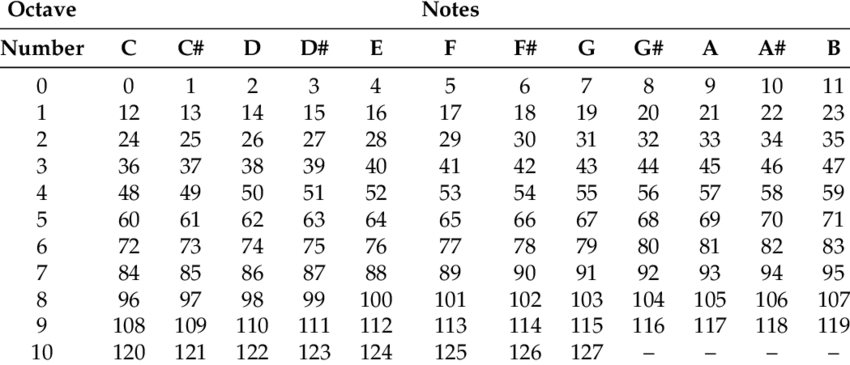

In [38]:
# Реализуйте функцию конвертации midi ноты в частоту
# Для этого изучите следующую статью : https://newt.phys.unsw.edu.au/jw/notes.html
def midi2freq(note):
    return 2 ** ((note - 69) / 12) * 440.0

### Задание 5. Синтез мелодии (4 балла).

1. Создайте (или найдите) несложную monophonic мелодию в сервисе  https://onlinesequencer.net/
2. Считайте midi
3. Распарсите его
4. Напишите функцию генерации на основе реализованных функций (не забудьте про гармоники)
5. Сгенерируйте звук
6. Выведите его и визуализируйте полученный сигнал

In [47]:
from tqdm import tqdm


def midi2wav(mid, sr=44100):
    notes = parsing_midi(mid)
    notes[:, 0] = midi2freq(notes[:, 0])
    tpb = mid.ticks_per_beat
    song = np.concatenate([harmonics(note[0], (note[3] - note[2]) / tpb, sr, [1.0, 1/5, 1/6, 1/7, 1/8, 1/9])
                            #create_sin(note[0], (note[3] - note[2]) / tpb, sr, note[1], 0)
                            for note in tqdm(notes)])
    return song

In [51]:
song = midi2wav(mid)
ipd.Audio(song, rate=44100)

100%|██████████| 28/28 [00:00<00:00, 288.58it/s]


In [52]:
np.array(song)

array([0.        , 0.08819985, 0.17568   , ..., 0.81236028, 0.83971482,
       0.87085014])

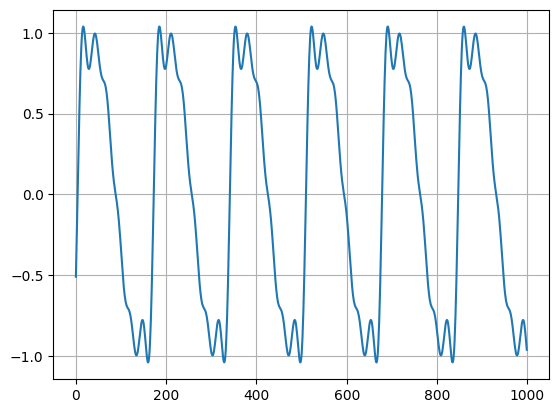

In [56]:
plt.plot(song[120000:120000 + 1000])
plt.grid()
plt.show()

In [54]:
mid = MidiFile('Undertale.mid', clip=True)
und_song = midi2wav(mid)
ipd.Audio(und_song, rate=44100)

100%|██████████| 112/112 [00:00<00:00, 271.76it/s]


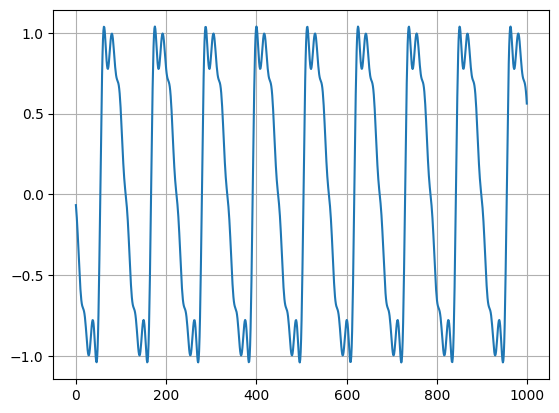

In [58]:
plt.plot(und_song[120000:120000 + 1000])
plt.grid()
plt.show()

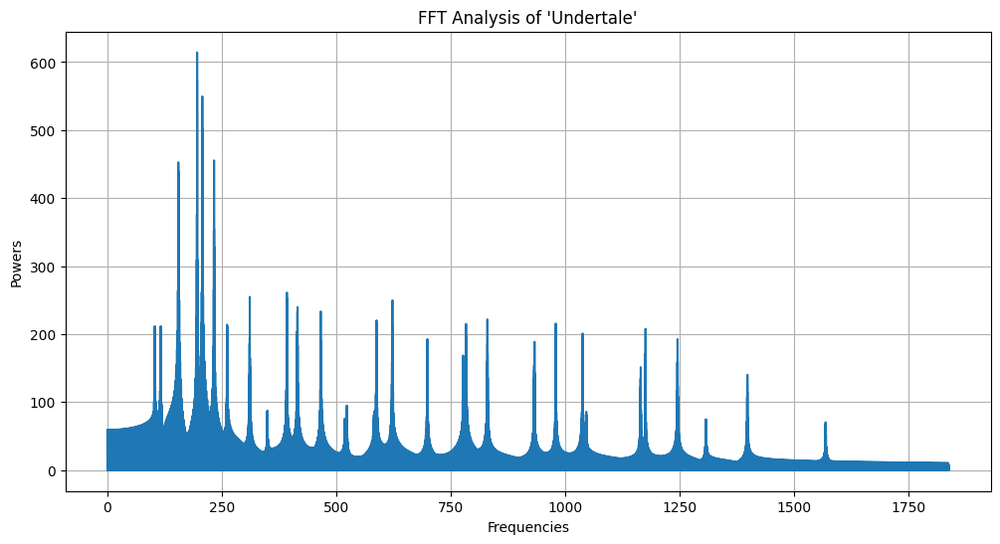

In [79]:
freqs, powers = get_spectrum(und_song)
plt.figure(figsize=(12, 6))
plt.plot(freqs[:len(freqs) // 12], powers[:len(freqs) // 12])
plt.grid()
plt.xlabel("Frequencies")
plt.ylabel("Powers")
plt.title(f"FFT Analysis of 'Undertale'")
plt.show()

In [ ]:
# Ваш код тут